In [14]:
import streamlit as st
import pandas as pd
import numpy as np 
import plotly.graph_objects as go
import plotly.express as px
import os
import json


In [112]:
# Load the GeoJSON data
with open('../data/raw/data.geojson') as f:
    geojson_data = json.load(f)

# Print sample feature
# print(geojson_data['features'][0])


# Flatten GeoJSON features to DataFrame
features = geojson_data['features']
df = pd.json_normalize(features)

df_pops = df[['attributes.B19BTOT', 'attributes.GMDNAME']]

df_pops
# Print DataFrame columns
# df
# # Plot using Plotly Express
# fig = px.choropleth_mapbox(
#     df,
#     geojson=geojson_data,
#     locations=df['attributes.GMDNAME'],  # Update if necessary
#     featureidkey="properties.GMDNAME",  # Update if necessary
#     color=df['attributes.B19BTOT'],  # Column for color
#     hover_name=df['attributes.GMDNAME'],  # Column for hover text
#     color_continuous_scale="Viridis",  # Adjust color scale
#     mapbox_style="carto-positron",
#     center={"lat": 47.0, "lon": 8.0},  # Center of Switzerland
#     zoom=7
# )

# # Update layout to remove margins
# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# # Show the plot
# fig.show()

/opt/anaconda3/envs/VIZ/lib/python3.10/site-packages/IPython/core/formatters.py:347: FutureWarning:

Index.format is deprecated and will be removed in a future version. Convert using index.astype(str) or index.map(formatter) instead.



,attributes.B19BTOT,attributes.GMDNAME
0,1981,Aeugst am Albis
1,5721,Obfelden
2,2293,Stadel
3,789,Doppleschwand
4,3280,Entlebuch
...,...,...
2207,606,Walliswil bei Wangen
2208,2321,Wangen an der Aare
2209,405,Wangenried
2210,2378,Wiedlisbach


In [124]:
df_pops['attributes.GMDNAME'] == 'Le Chenit'

0       False
1       False
2       False
3       False
4       False
        ...  
2207    False
2208    False
2209    False
2210    False
2211    False
Name: attributes.GMDNAME, Length: 2212, dtype: bool

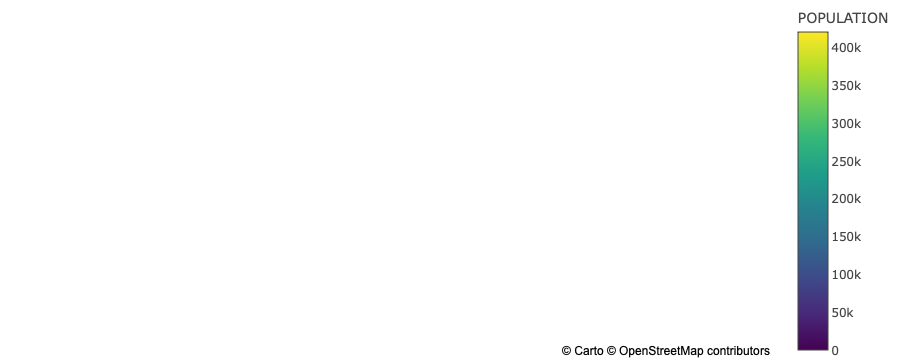

In [68]:
import json
import pandas as pd
import plotly.express as px
import geopandas as gpd
from shapely.geometry import Polygon

# Load GeoJSON data
with open('../data/raw/data.geojson') as f:
    geojson_data = json.load(f)

# Function to convert 'rings' to a Polygon
def rings_to_polygon(rings):
    if rings:
        # Convert the first ring to a Polygon
        return Polygon(rings[0])
    return None

# Process the features to extract geometry and attributes
data = []
for feature in geojson_data['features']:
    geometry = feature.get('geometry', {})
    rings = geometry.get('rings')
    if rings:
        polygon = rings_to_polygon(rings)
        attributes = feature.get('attributes', {})
        data.append({
            'geometry': polygon,
            'POPULATION': attributes.get('B19BTOT', None),
            'NAME': attributes.get('GMDNAME', None)
        })

# Create a DataFrame from the processed data
df = pd.DataFrame(data)

# Convert to GeoDataFrame
gdf = gpd.GeoDataFrame(df, geometry='geometry')

# Plot using Plotly Express
fig = px.choropleth_mapbox(
    gdf,
    geojson=gdf.geometry.__geo_interface__,
    locations=gdf.index,  # Use DataFrame index for locations
    color='POPULATION',  # Column to color by
    hover_name='NAME',  # Column for hover text
    color_continuous_scale="Viridis",
    mapbox_style="carto-positron",
    center={"lat": 47.0, "lon": 8.0},  # Center of Switzerland
    zoom=7
)

# Update layout to remove margins
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# Show the plot
fig.show()


In [84]:
from arcgis.geometry import Polygon, Point
import arcgis
import json

# Load the GeoJSON data
with open('../data/raw/data.geojson') as f:
    geojson_data = json.load(f)

# Extract rings from GeoJSON and convert them into ArcGIS Polygon objects
geometries = []
for feature in geojson_data['features']:
    rings = feature['geometry']['rings']
    attributes = feature['attributes']
    
    # Create Polygon object from the rings
    polygon = Polygon({"rings": rings, "spatialReference": {"wkid": 2056}})
    
    # You can now work with this polygon, for example, find centroid or convert to points
    centroid = polygon.centroid
    points = [Point(pt) for pt in rings[0]]  # Convert all ring coordinates to Point objects
    
    # You can now store or visualize these points
    geometries.append({
        "polygon": polygon,
        "centroid": centroid,
        "points": points,
        "attributes": attributes
    })

# Print or check one of the geometries
# geojson_data['features']

# geometries[0]


{'polygon': {'rings': [[[2678219, 1235219],
    [2678560, 1235856],
    [2678206, 1236419],
    [2678196, 1237038],
    [2678259, 1237306],
    [2678520, 1237272],
    [2678123, 1237563],
    [2678568, 1238078],
    [2679069, 1238116],
    [2679202, 1238533],
    [2679735, 1238325],
    [2679758, 1238485],
    [2680539, 1237741],
    [2680802, 1237767],
    [2681155, 1237447],
    [2681130, 1237060],
    [2680945, 1236497],
    [2680610, 1236347],
    [2680402, 1236295],
    [2680489, 1235030],
    [2680409, 1235056],
    [2679258, 1234882],
    [2679123, 1234607],
    [2678219, 1235219]]],
  'spatialReference': {'wkid': 2056}},
 'centroid': (2679518.262684999, 1236631.2207055602),
 'points': [{'x': 2678219, 'y': 1235219, 'spatialReference': {'wkid': 4326}},
  {'x': 2678560, 'y': 1235856, 'spatialReference': {'wkid': 4326}},
  {'x': 2678206, 'y': 1236419, 'spatialReference': {'wkid': 4326}},
  {'x': 2678196, 'y': 1237038, 'spatialReference': {'wkid': 4326}},
  {'x': 2678259, 'y': 12373

In [94]:
from arcgis.geometry import Polygon
from arcgis.features import FeatureSet
import json
import plotly.express as px

# Load the GeoJSON file
geojson_path = '../data/raw/data.geojson'
with open(geojson_path) as f:
    geojson_data = json.load(f)

# Convert rings into Polygon geometry using ArcGIS
features = geojson_data['features']
polygon_features = []

for feature in features:
    rings = feature['geometry']['rings']  # Extract the rings data
    polygon = Polygon({'rings': rings})  # Convert the rings to a Polygon
    polygon_features.append({
        'geometry': polygon,
        'attributes': feature['attributes']  # Preserve the attributes
    })

# Create FeatureSet for ArcGIS
feature_set = FeatureSet(polygon_features)

# Convert to GeoJSON
geojson_converted = feature_set.to_geojson

# Save the converted GeoJSON
with open('converted_pop_cant.geojson', 'w') as f:
    f.write(geojson_converted)


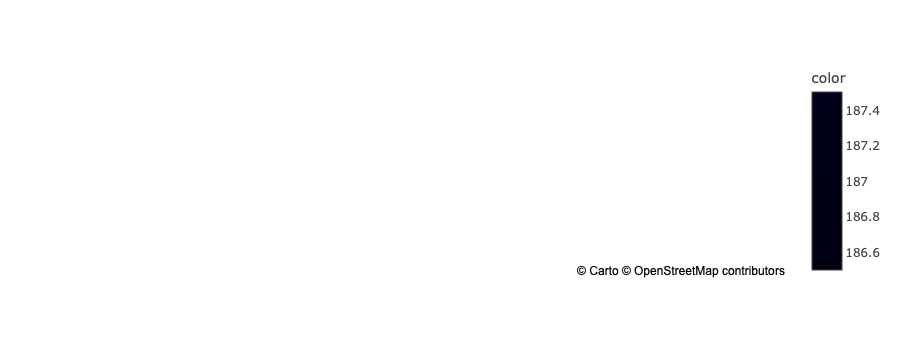

In [98]:
# Load the converted GeoJSON
with open('converted_pop_cant.geojson') as f:
    geojson_data = json.load(f)

# Plot using Plotly
fig = px.choropleth_mapbox(
    geojson=geojson_data,
    locations=[feature['attributes']['GMDNAME'] for feat in geojson_data['features']],
    featureidkey="properties.GMDNAME",  # Match the property in the GeoJSON
    color=[feature['attributes']['B19BTOT'] for feat in geojson_data['features']],  # Use population data
    mapbox_style="carto-positron",
    center={"lat": 47.0, "lon": 8.0},  # Center on Switzerland
    zoom=7
)

fig.show()


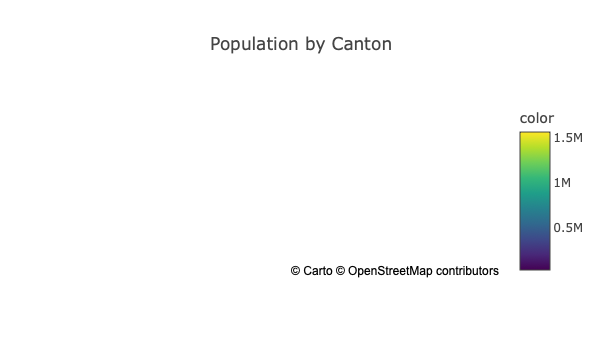

In [11]:
# import plotly.express as px
# import json

# # Load GeoJSON data
# with open('../data/raw/pop_cant.geojson') as f:
#     geojson_data = json.load(f)

# # Create a Plotly map
# fig = px.choropleth_mapbox(
#     # geojson=geojson_data,
#     locations=[feature['properties']['NAME_1'] for feature in geojson_data['features']],  # Extract place names
#     color=[feature['properties']['POPULATION'] for feature in geojson_data['features']],  # Extract population values
#     geojson=geojson_data,
#     featureidkey="properties.NAME_1",  # Property name in GeoJSON
#     color_continuous_scale="Viridis",  # Color scale
#     mapbox_style="carto-positron",
#     center={"lat": 47.0, "lon": 8.0},  # Center map on Switzerland (adjust as necessary)
#     zoom=7,
#     title="Population by Canton"
# )

# fig.show()


In [5]:


# df = pd.read_csv('../data/processed/geojson_df_including_pops.csv', encoding='utf-8')

# with open('../data/raw/d.geojson') as f:
#     geojson_data = json.load(f)

# # Create the choropleth map using Plotly Express
# fig = px.choropleth_mapbox(df,
#                            geojson=geojson_data,
#                            locations='BEZIRKSNUM', # this must match featureidkey
#                            featureidkey="properties.BEZIRKSNUM",  # This must match the property in your GeoJSON
#                            color='EINWOHNERZ',
#                            mapbox_style="carto-positron",
#                            center={"lat": 47.0, "lon": 8.0},  # Switzerland coordinates
#                            zoom=7)

# fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

# fig.show()


KeyboardInterrupt: 

In [30]:
# df = pd.read_csv('../data/processed/geojson_df_including_pops.csv')

# df

# # Convert columns to a dictionary of lists
# dict_of_lists = {
#     'BEZIRKSNUM': df['BEZIRKSNUM'].tolist(),
#     'EINWOHNERZ': df['EINWOHNERZ'].tolist()
# }

# # Output the dictionary
# print(len(dict_of_lists['BEZIRKSNUM']))

# # dframe = {
# #     'BEZIRKSNUM': df[['BEZIRKSNUM']],  # Example district number (must match "BEZIRKSNUM" in GeoJSON)
# #     'EINWOHNERZ': df[['EINWOHNERZ']]  # Example population data to map
# # }

# # type(df)

# # type(print("HI"))


# # print("HI")

159


In [ ]:
bz